# Gene Expression Analysis

In [1]:
from google.colab import drive
drive.mount('/MultiClusterGAN')
%cd /MultiClusterGAN/MyDrive/CNS/
%pip install  umap-learn scanpy

Mounted at /MultiClusterGAN
/MultiClusterGAN/MyDrive/CNS
     |████████████████████████████████| 86 kB 5.6 MB/s 
     |████████████████████████████████| 2.0 MB 61.5 MB/s 
     |████████████████████████████████| 1.1 MB 65.4 MB/s 
     |████████████████████████████████| 91 kB 10.5 MB/s 
     |████████████████████████████████| 63 kB 1.8 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.2-py3-none-any.whl size=82708 sha256=a16b79e9549e5c9a2836a4b57a1d46ada5ec66f56c070ad6c38274a0fcb597df
  Stored in directory: /root/.cache/pip/wheels/84/1b/c6/aaf68a748122632967cef4dffef68224eb16798b6793257d82
  Created wheel for pynndescent: filename=pynndescent-0.5.6-py3-none-any.whl size=53943 sha256=99472efe37dbb460db65b9b39092eaef290da91d6982ce68d0dc215a4a4d6fb6
  Stored in directory: /root/.cache/pip/wheels/03/f1/56/f80d72741e400345b5a5b50ec3d929aca581bf45e0225d5c50
  Created wheel for sinfo: filename=sinfo-0.3.4-py3-none-any.whl size=7899 sha256=d8fcc6bfdec6240bea9da50ff6397ac19758b9835b27

In [2]:
# Loading the Packages

%reload_ext autoreload
%autoreload 2

import os
import warnings 
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns

from tifffile import tifffile
from scipy import ndimage

# from starmap.obj import STARMapDataset, load_data
# import starmap.analyze as anz
# import starmap.viz as viz
# import starmap.sc_util as su
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

import plotly.graph_objects as go
from sklearn.neighbors import NearestNeighbors
from tqdm import tqdm
from anndata import AnnData

In [3]:
# Colormap related
import colorsys
from random import shuffle

def intervals(parts, start_point, end_point):
    duration = end_point - start_point
    part_duration = duration / parts
    return [((i * part_duration + (i + 1) * part_duration)/2) + start_point for i in range(parts)]

## Input

In [ ]:
# plot_path='tissue_region/output_data'
# combine_adata_st_obs=pd.read_csv(plot_path+'/combine_adata_st_obs.csv')
# combine_adata_st_obs.loc[combine_adata_st_obs['Rank4_Refine']=='Vascular smooth muscle cells ','Rank4_Refine']='Vascular smooth muscle cells'

# from sklearn import preprocessing
# le = preprocessing.LabelEncoder()
# le.fit(combine_adata_st_obs['Rank5_Symbol'])
# # le.transform(combine_adata_st_obs['Rank5_Symbol'])

# combine_adata_st_obs['celltypeid_all']=le.transform(combine_adata_st_obs['Rank5_Symbol'])

read ncc data


In [ ]:
cmap=np.random.rand(76,3)

In [ ]:
# adata1=sc.read_h5ad('adata_leiden_0212_final.h5ad')
# adata1=sc.read_h5ad('adata_leiden_0212_final_0_9.h5ad')
adata1=sc.read_h5ad('adata1_with_tissue_label.h5ad')

In [ ]:
# random.seed(100)
# sc.pl.umap(adata1, legend_loc='on data',color='tissue', palette=list(cmap))

end

plot all samples

In [ ]:
coronals = {
    'spinalcord',
    'well01brain',
    'well01OB',
    'well03',
    'well04',
    'well05',
    'well06',
    'well07',
    'well08',
    'well09',
    'well10',
    'well11',
    'well1_5',
    'well2_5',
    'well3_5',
    'well7_5',
    'well10_5',
    'sagittal1',
    'sagittal2',
    'sagittal3'
}
prefix = "tissue_region/output_data/"

cell_meta_data = [pd.read_csv(prefix + f"adata_obs_well_{coronal}.csv") for coronal in coronals]

cell_meta_data_concatenated = pd.concat(cell_meta_data)

In [ ]:
for i in coronals:
  cell_meta_data_concatenated.loc[cell_meta_data_concatenated['sample']==i,'tissue_id']=list(adata1.obs.loc[adata1.obs['sample']==i,'tissue'])
  cell_meta_data_concatenated.loc[cell_meta_data_concatenated['sample']==i,'anatomical_region_label']=list(adata1.obs.loc[adata1.obs['sample']==i,'anatomical_region_label'])
  cell_meta_data_concatenated.loc[cell_meta_data_concatenated['sample']==i,'anatomical_parent_region_label']=list(adata1.obs.loc[adata1.obs['sample']==i,'anatomical_parent_region_label'])
  

In [ ]:
# cmap=np.random.rand(100,3)
# for i in coronals:
#   test=cell_meta_data_concatenated.loc[cell_meta_data_concatenated['sample']==i,:]
#   plt.figure(figsize=(8,10))
#   plt.scatter(test['row'],test['col'],c=cmap[[int(x) for x in test['tissue_id']]],s=1)

In [ ]:
# from tqdm import tqdm
# for i in tqdm(np.arange(1091527)):
#   i_sample=cell_meta_data_concatenated.iloc[i]['sample']
#   i_col=cell_meta_data_concatenated.iloc[i]['col']
#   i_row=cell_meta_data_concatenated.iloc[i]['row']
#   test=adata1.obs.loc[(adata1.obs['sample']==i_sample) & (adata1.obs['col']==i_col) & (adata1.obs['row']==i_row ),:]
#   if test.shape[0]==1:
#     cell_meta_data_concatenated.iloc[i]['tissue_id']=list(test['tissue'])
#     cell_meta_data_concatenated.iloc[i]['anatomical_region_label']=list(test['anatomical_region_label'])
#     cell_meta_data_concatenated.iloc[i]['anatomical_parent_region_label']=list(test['anatomical_parent_region_label'])
#   else:
#     print('error')
#     break

In [ ]:
cell_meta_data_concatenated.to_csv('cell_meta_data_concatenated_tissue.csv')

end

In [ ]:
# image05 = tifffile.imread('J:\\ClusterMap2\\ccf\\AP_histology-master_sagittal\\slices\\annotation\\ccf_well07_celltypemap-rgb-1.tif');

# sx = ndimage.sobel(image05,axis=0,mode='constant')
# sy = ndimage.sobel(image05,axis=1,mode='constant')
# sobel=np.hypot(sx,sy)
# out_tpl05 = np.nonzero(sobel)

In [ ]:
# image06 = tifffile.imread('J:\\ClusterMap2\\ccf\\AP_histology-master_sagittal\\slices\\annotation\\ccf_well7_5_celltypemap-rgb-1.tif');

# sx = ndimage.sobel(image06,axis=0,mode='constant')
# sy = ndimage.sobel(image06,axis=1,mode='constant')
# sobel=np.hypot(sx,sy)
# out_tpl06 = np.nonzero(sobel)

In [ ]:
# image11 = tifffile.imread('J:\\ClusterMap2\\ccf\\AP_histology-master_sagittal\\slices\\annotation\\ccf_well08_celltypemap-rgb-1.tif');

# sx = ndimage.sobel(image11,axis=0,mode='constant')
# sy = ndimage.sobel(image11,axis=1,mode='constant')
# sobel=np.hypot(sx,sy)
# out_tpl11 = np.nonzero(sobel)

without adjacency

In [ ]:
coronals = [
    'well01brain',
    'well01OB',
    'well03',
    'well04',
    'well05',
    'well06',
    'well07',
    'well08',
    'well09',
    'well10',
    'well11',
    'well1_5',
    'well2_5',
    'well3_5',
    'well7_5',
    'well10_5',
    'sagittal1',
    'sagittal2',
    'sagittal3',
]

In [ ]:
# obs_wellplot=adata1.obs.loc[adata1.obs['sample']=='well06',:]

# image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_well06_celltypemap-rgb-1.tif');

# sx = ndimage.sobel(image04,axis=0,mode='constant')
# sy = ndimage.sobel(image04,axis=1,mode='constant')
# sobel=np.hypot(sx,sy)
# out_tpl04 = np.nonzero(sobel)

# out_tplplot=out_tpl04

# plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
# plt.scatter(obs_wellplot['row'],max(obs_wellplot['col'])-obs_wellplot['col'],
#            c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
# plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
# plt.axis('off')

In [ ]:
c=cmap[[int(x) for x in obs_wellplot['tissue']]]

(-2592.6000000000004, 54444.6, -1229.1116028708122, 31110.34366028705)

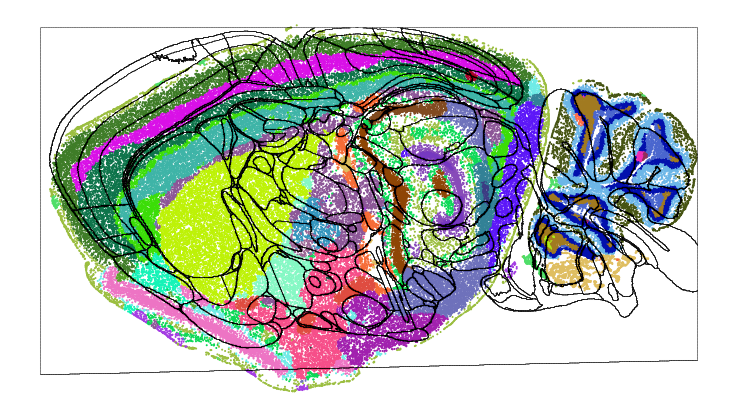

In [ ]:
i=16
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[0]*12,out_tplplot[1]*12,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-3428.9301369863006, 72007.5328767123, -1674.95, 35173.95)

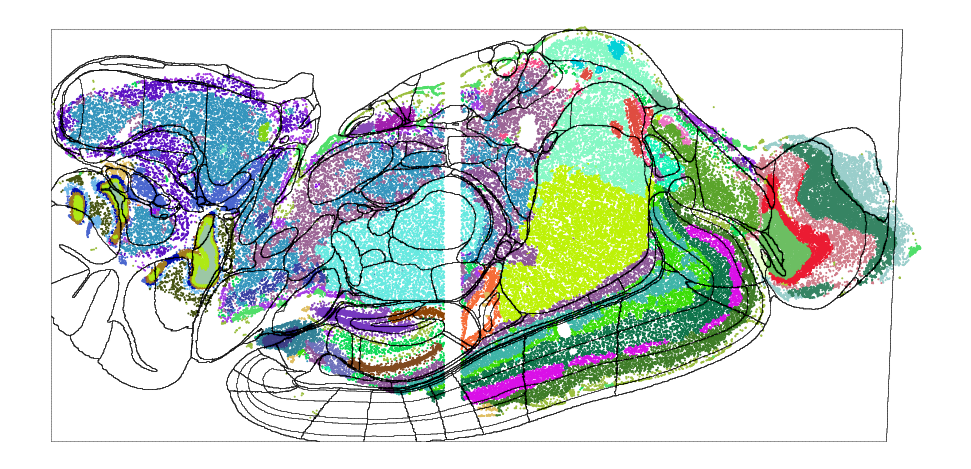

In [ ]:
i=17
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*15,out_tplplot[0]*15,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-3849.8068181818185,
 81310.94318181818,
 -1947.8030769230752,
 40903.86461538458)

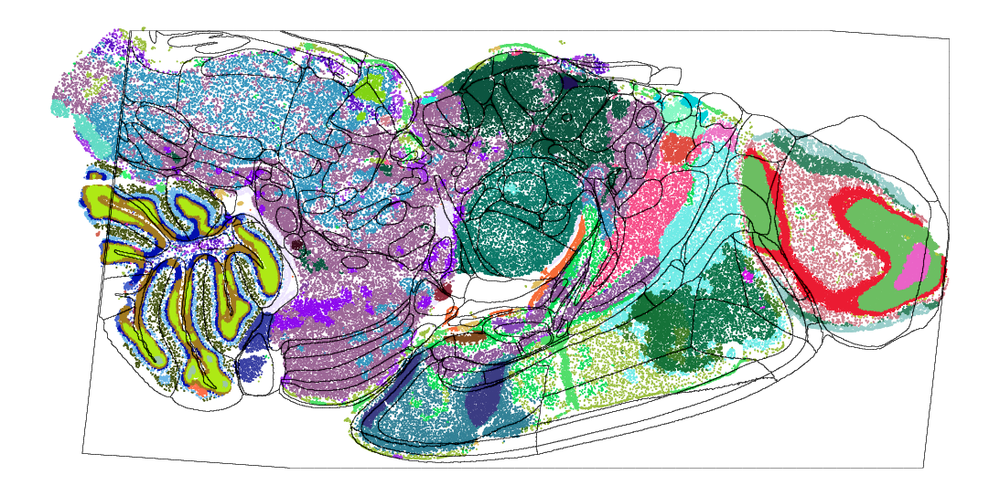

In [ ]:
i=18
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*16,out_tplplot[0]*16,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-949.5, 19939.5, -1350.0, 28350.0)

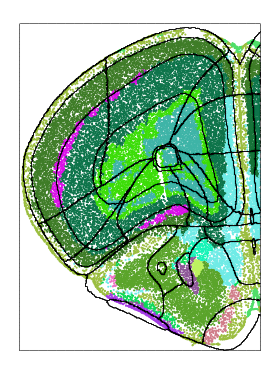

In [ ]:
i=0
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-545.5, 11455.5, -680.0, 14280.0)

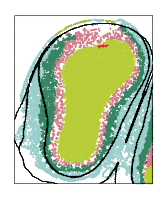

In [ ]:
i=1
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],max(obs_wellplot['col'])-obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1084.0, 22764.0, -1486.5, 31216.5)

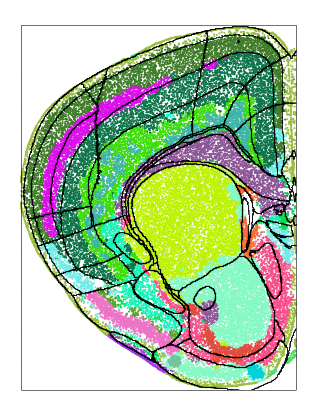

In [ ]:
i=2
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1285.0, 26985.0, -1689.6984375000002, 35483.6671875)

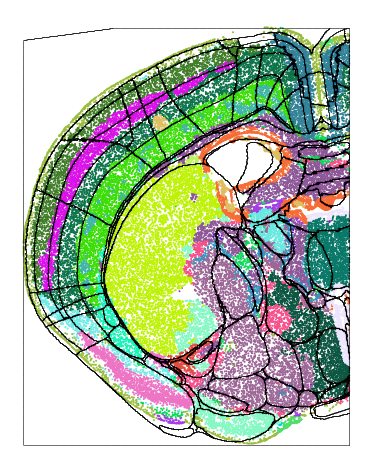

In [ ]:
i=3
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1353.0, 28413.0, -1597.0244680851051, 33537.5138297872)

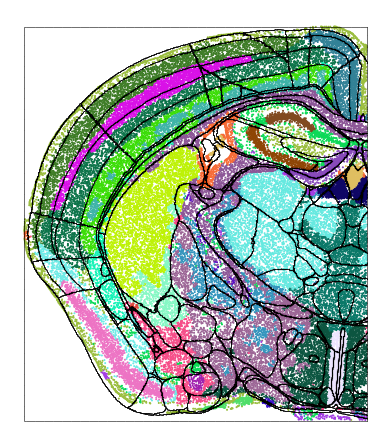

In [ ]:
i=4
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1353.0, 28413.0, -1689.0, 35469.0)

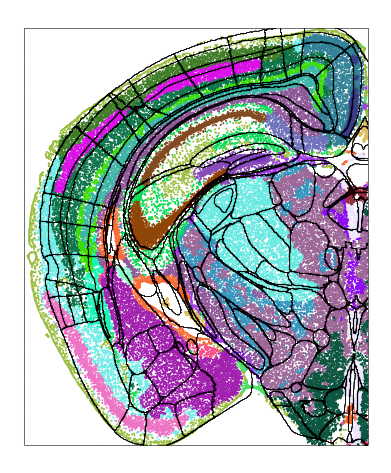

In [ ]:
i=5
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],max(obs_wellplot['col'])-obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1281.0, 26901.0, -1398.0, 29358.0)

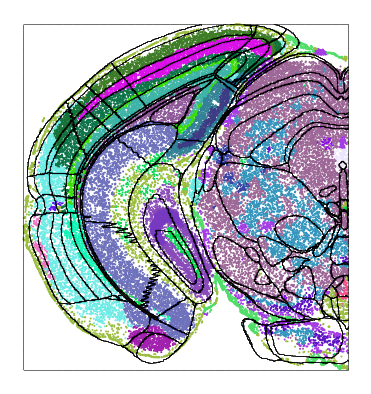

In [ ]:
i=6
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1144.5, 24034.5, -1468.0, 30828.0)

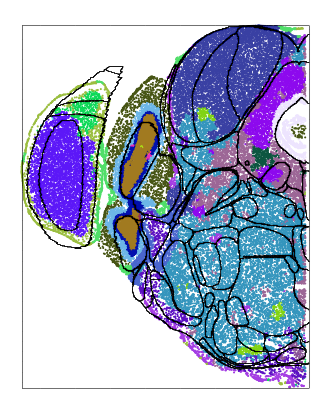

In [ ]:
i=7
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1218.5, 25588.5, -1411.5, 29641.5)

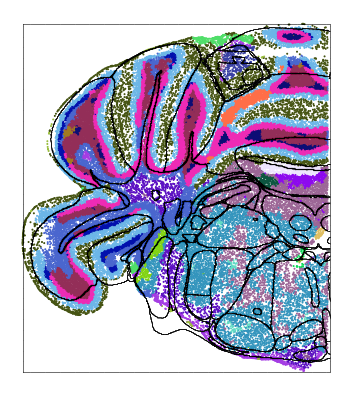

In [ ]:
i=8
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1146.0, 24066.0, -1555.0, 32655.0)

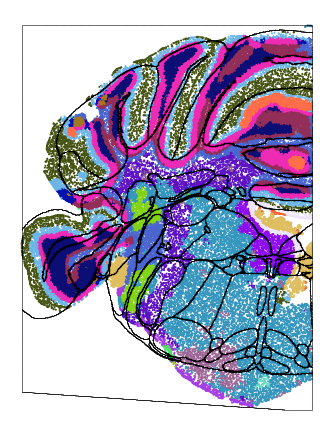

In [ ]:
i=9
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1285.69769230769, 26999.65153846149, -1753.5, 36823.5)

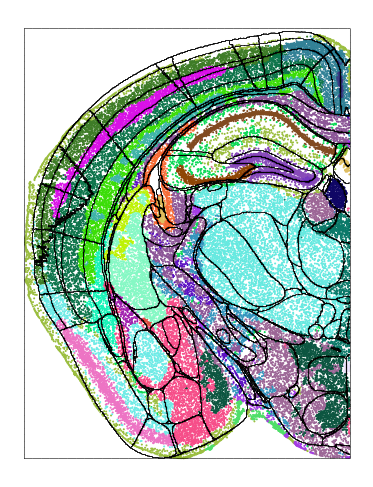

In [ ]:
i=10
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],max(obs_wellplot['col'])-obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-545.5, 11455.5, -864.5, 18154.5)

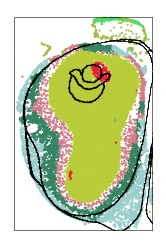

In [ ]:
i=11
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['col'],obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1075.5, 22585.5, -1339.5, 28129.5)

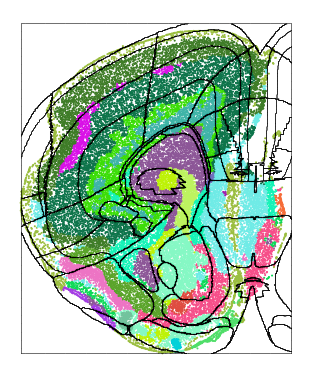

In [ ]:
i=12
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(max(obs_wellplot['col'])-obs_wellplot['col'],max(obs_wellplot['row'])-obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1151.0, 24171.0, -1554.5, 32644.5)

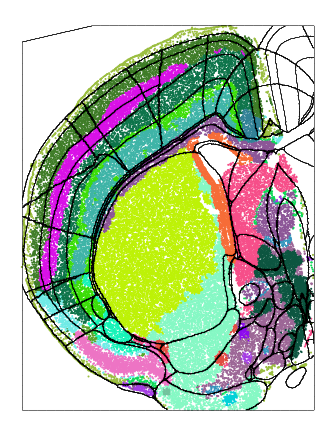

In [ ]:
i=13
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(max(obs_wellplot['col'])-obs_wellplot['col'],max(obs_wellplot['row'])-obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-1353.0, 28413.0, -1417.5, 29767.5)

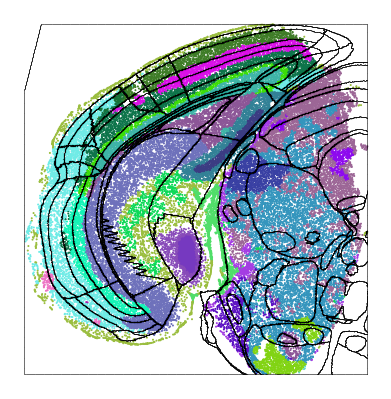

In [ ]:
i=14
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['col'],obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

(-991.5, 20821.5, -1616.0294200497108, 33936.617821043925)

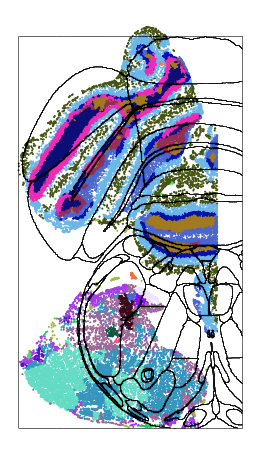

In [ ]:
i=15
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['col'],max(obs_wellplot['row'])-obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

end

explaining anatomical regions

(-949.5, 19939.5, -1350.0, 28350.0)

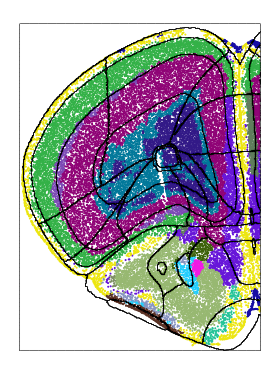

In [ ]:
i=0
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


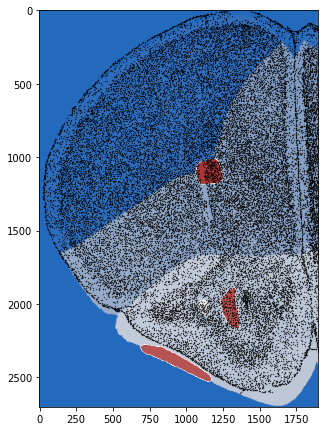

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04,cmap='vlag')
plt.scatter((obs_wellplot['row'])/10,(max(obs_wellplot['col'])-(obs_wellplot['col']))/10,s=0.1,c='k')

In [ ]:
rowlist=list(obs_wellplot['row']/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label
anatomical_region_id
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_id']=anatomical_region_id


(-709.4667410714301, 19919.614062500033, -880.6735589353618, 27773.29302661597)

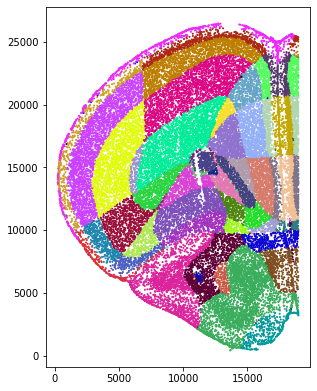

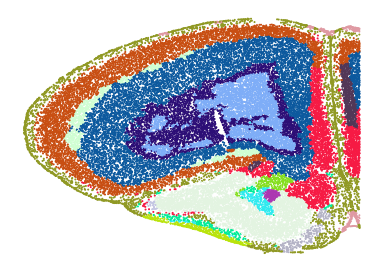

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-545.5, 11455.5, -680.0, 14280.0)

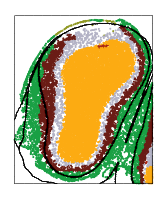

In [ ]:
i=1
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],max(obs_wellplot['col'])-obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


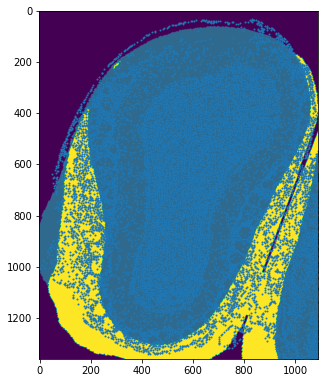

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter(obs_wellplot['row']/10,(obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list(obs_wellplot['row']/10)
collist=list(obs_wellplot['col']/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-508.2344470046075,
 11449.310483870951,
 -345.44051067073144,
 14257.226333841463)

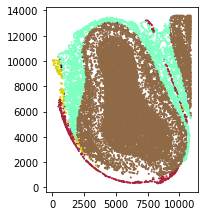

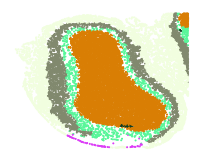

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-1084.0, 22764.0, -1486.5, 31216.5)

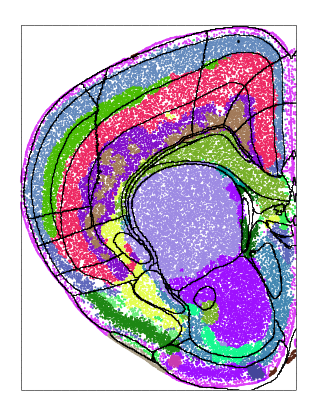

In [ ]:
i=2
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


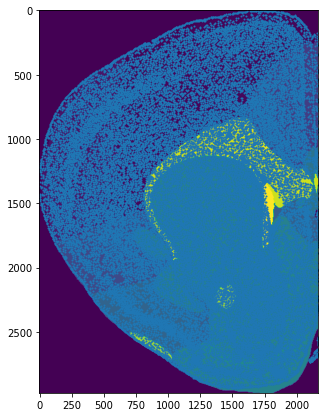

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['row'])-obs_wellplot['row'])/10,(max(obs_wellplot['col'])-obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1077.3817818740413,
 22758.436774193575,
 -1319.0786392405062,
 30986.170411392406)

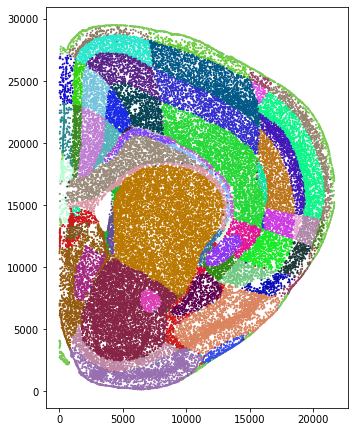

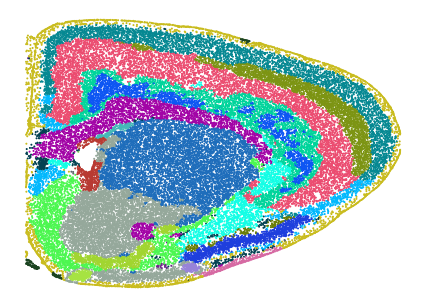

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-1285.0, 26985.0, -1689.6984375000002, 35483.6671875)

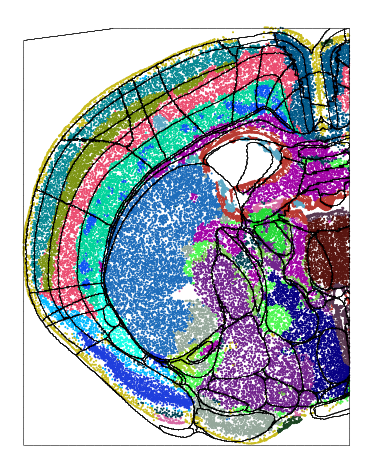

In [ ]:
i=3
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


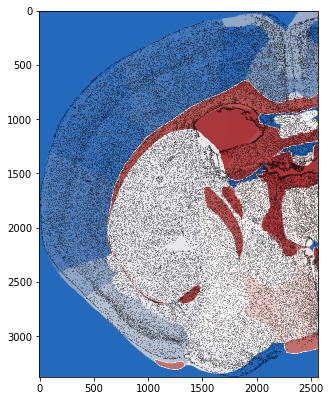

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04,cmap='vlag')
plt.scatter((max(obs_wellplot['row'])-obs_wellplot['row'])/10,(max(obs_wellplot['col'])-obs_wellplot['col'])/10,s=0.01,c='k')

In [ ]:
rowlist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1276.2404761904781, 26984.233673469425, -1575.1644375, 35478.2131875)

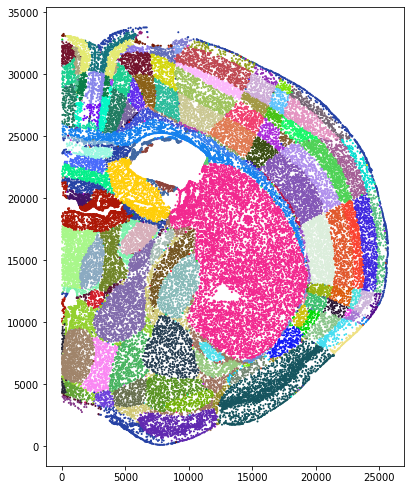

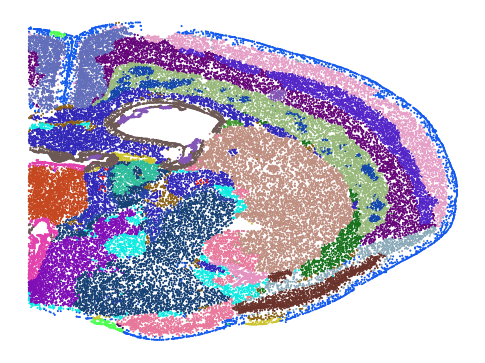

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-1353.0, 28413.0, -1597.0244680851051, 33537.5138297872)

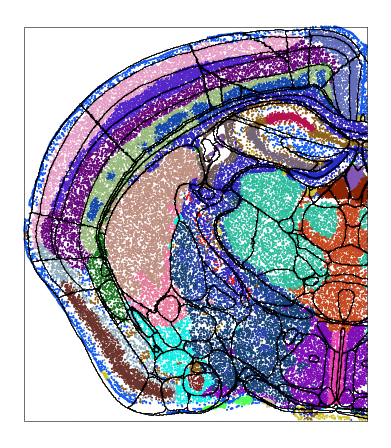

In [ ]:
i=4
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


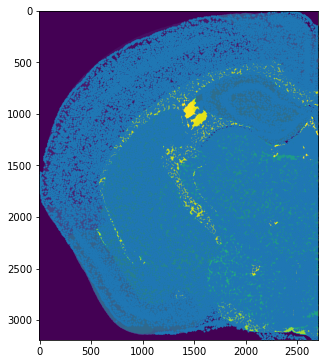

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['row'])-obs_wellplot['row'])/10,(max(obs_wellplot['col'])-obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1318.752396761135,
 28398.093665317167,
 -1509.3494680851052,
 33533.33882978721)

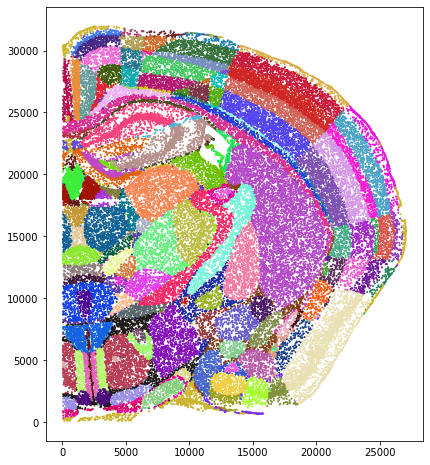

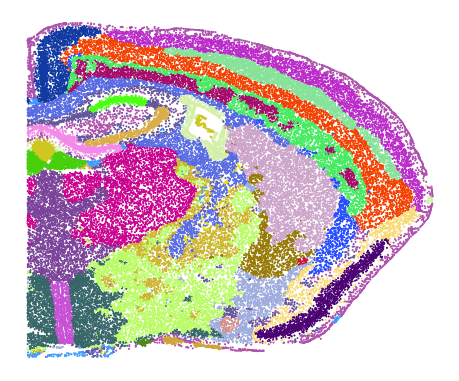

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-1353.0, 28413.0, -1689.0, 35469.0)

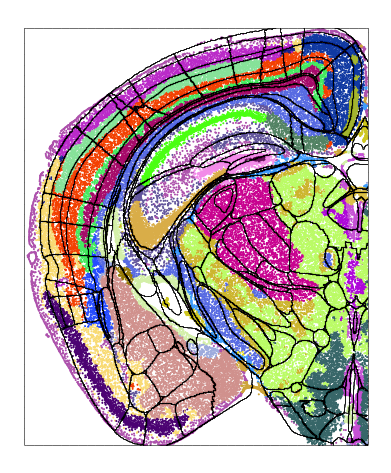

In [ ]:
i=5
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],max(obs_wellplot['col'])-obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


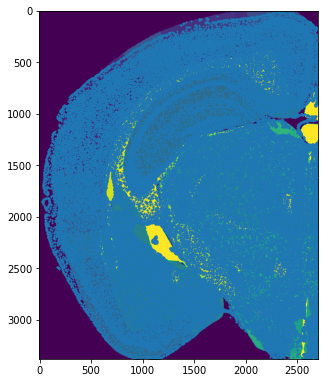

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter(obs_wellplot['row']/10,(obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list(obs_wellplot['row']/10)
collist=list(obs_wellplot['col']/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1079.4483062330617,
 28399.682723577214,
 -1549.4816028225807,
 35465.924719182025)

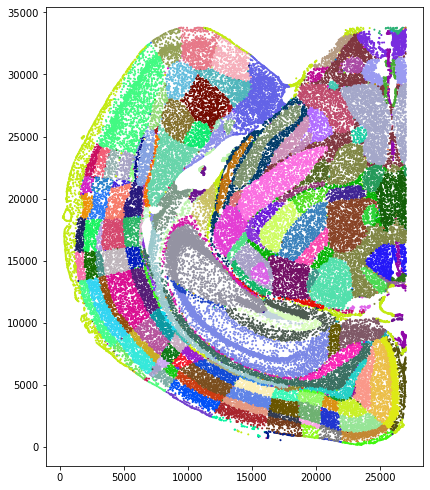

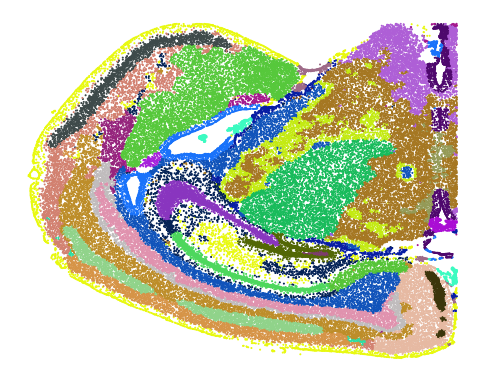

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-1281.0, 26901.0, -1398.0, 29358.0)

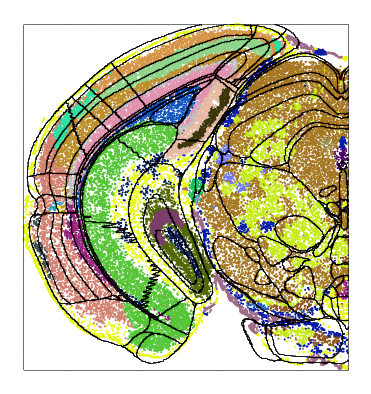

In [ ]:
i=6
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


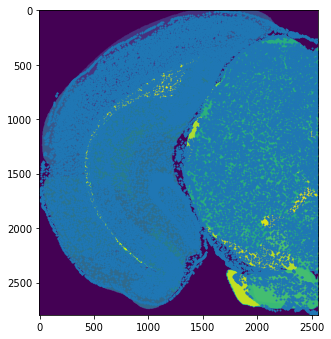

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['row'])-obs_wellplot['row'])/10,(max(obs_wellplot['col'])-obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1270.7297527706744,
 26892.89002557547,
 -1378.0694251290886,
 29352.686843373507)

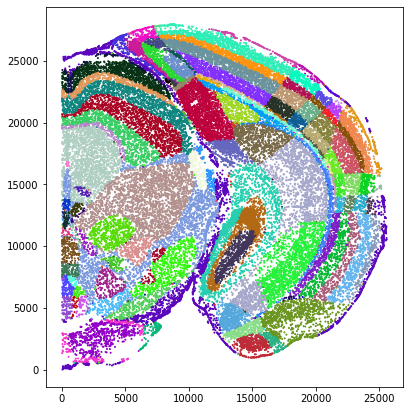

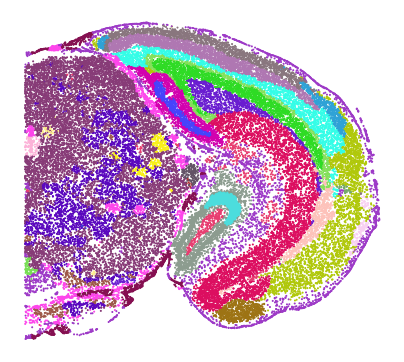

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-1144.5, 24034.5, -1468.0, 30828.0)

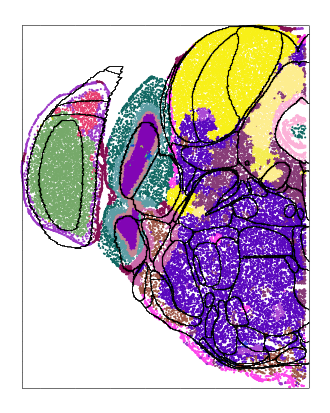

In [ ]:
i=7
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


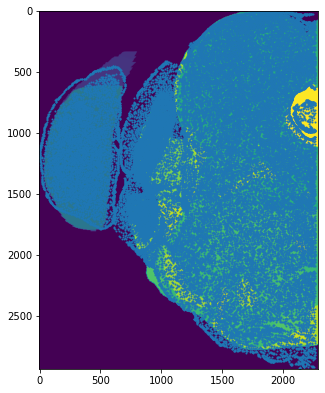

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['row'])-obs_wellplot['row'])/10,(max(obs_wellplot['col'])-obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


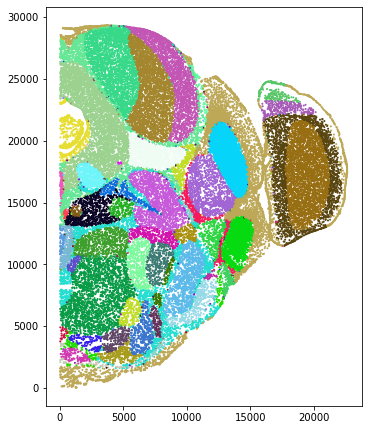

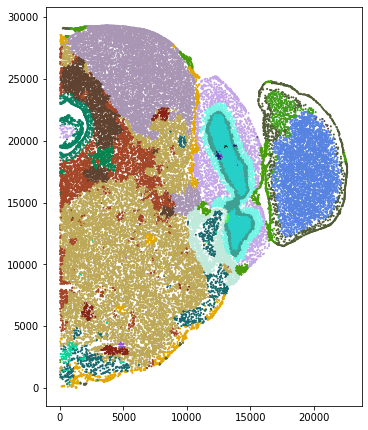

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)

(-1218.5, 25588.5, -1411.5, 29641.5)

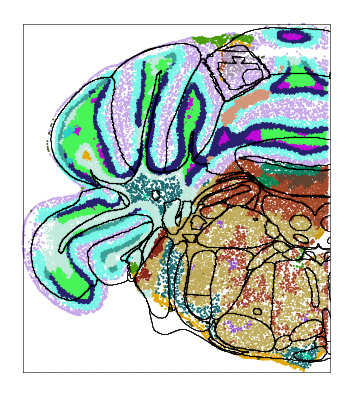

In [ ]:
i=8
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


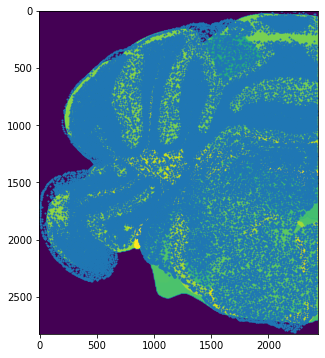

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['row'])-obs_wellplot['row'])/10,(max(obs_wellplot['col'])-obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


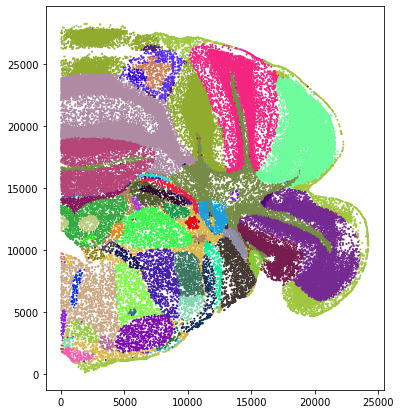

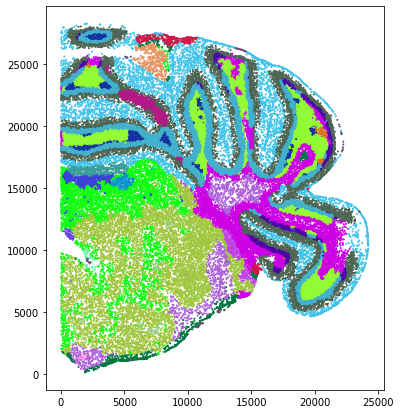

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)

(-1146.0, 24066.0, -1555.0, 32655.0)

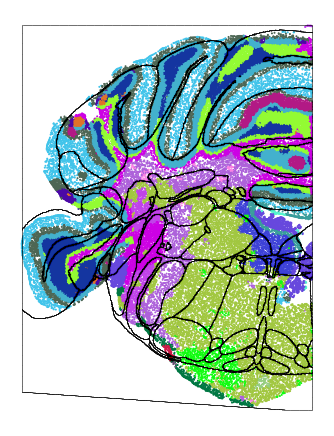

In [ ]:
i=9
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(max(obs_wellplot['row'])-obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


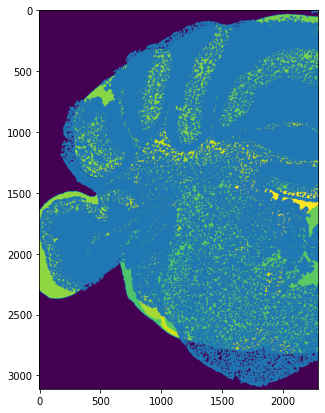

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['row'])-obs_wellplot['row'])/10,(max(obs_wellplot['col'])-obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)
collist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


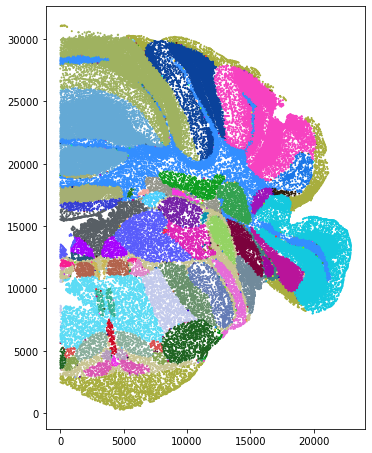

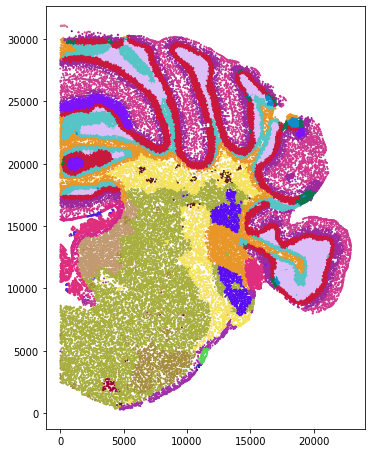

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)

(-1285.69769230769, 26999.65153846149, -1753.5, 36823.5)

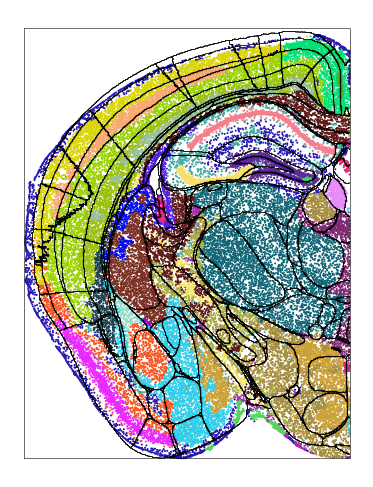

In [ ]:
i=10
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],max(obs_wellplot['col'])-obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


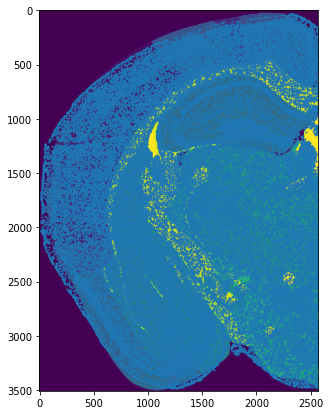

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter(obs_wellplot['row']/10,(obs_wellplot['col'])/10,s=1)

In [ ]:
rowlist=list(obs_wellplot['row']/10)
collist=list(obs_wellplot['col']/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


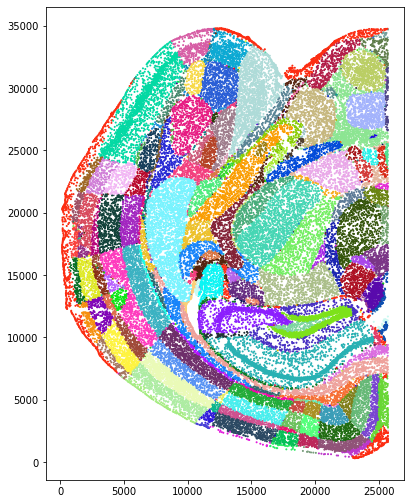

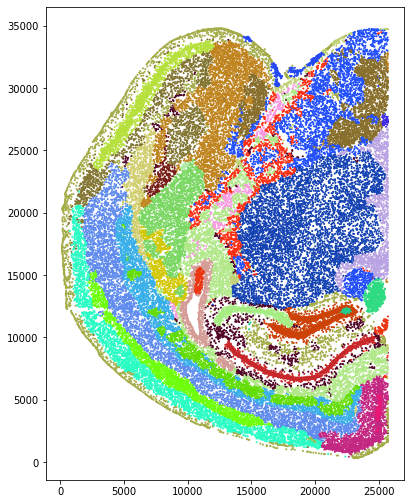

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)

(-545.5, 11455.5, -864.5, 18154.5)

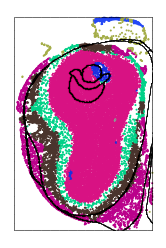

In [ ]:
i=11
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['col'],obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


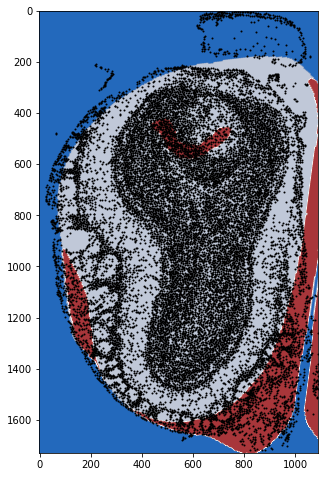

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04,cmap='vlag')
plt.scatter((obs_wellplot['col'])/10,(max(obs_wellplot['row'])-obs_wellplot['row'])/10,s=1,c='k')

In [ ]:
rowlist=list((obs_wellplot['col'])/10)
collist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


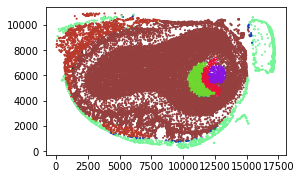

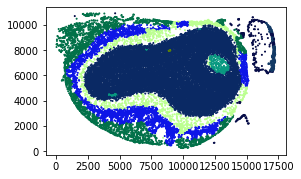

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)

(-1075.5, 22585.5, -1339.5, 28129.5)

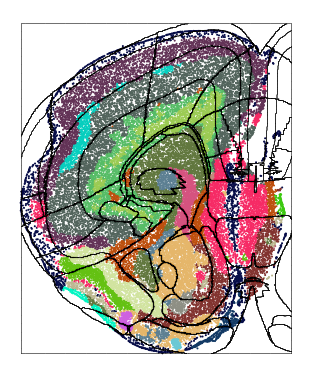

In [ ]:
i=12
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(max(obs_wellplot['col'])-obs_wellplot['col'],max(obs_wellplot['row'])-obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


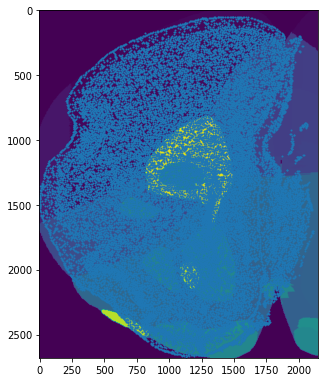

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['col'])-obs_wellplot['col'])/10,(obs_wellplot['row'])/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)
collist=list((obs_wellplot['row'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


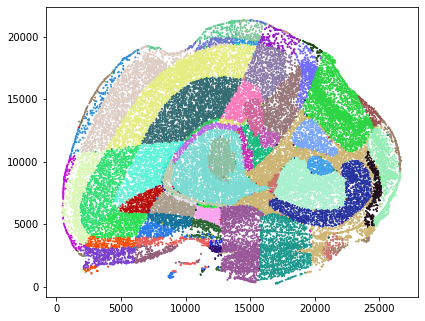

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)

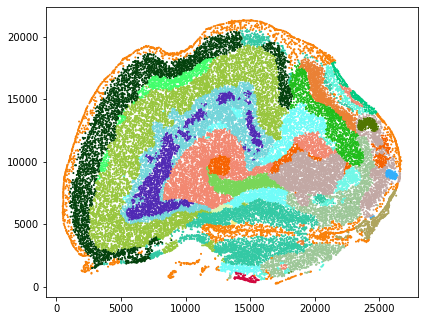

In [ ]:
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)

(-1151.0, 24171.0, -1554.5, 32644.5)

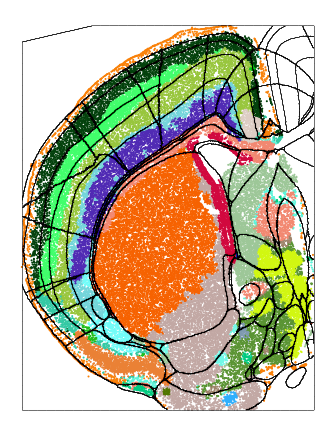

In [ ]:
i=13
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(max(obs_wellplot['col'])-obs_wellplot['col'],max(obs_wellplot['row'])-obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


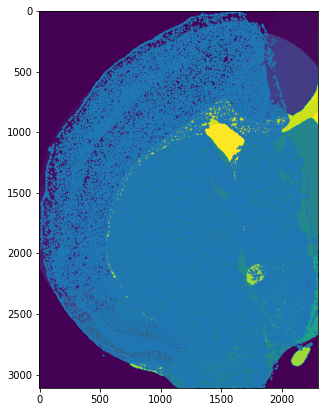

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((max(obs_wellplot['col'])-obs_wellplot['col'])/10,obs_wellplot['row']/10,s=1)

In [ ]:
rowlist=list((max(obs_wellplot['col'])-obs_wellplot['col'])/10)
collist=list(obs_wellplot['row']/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


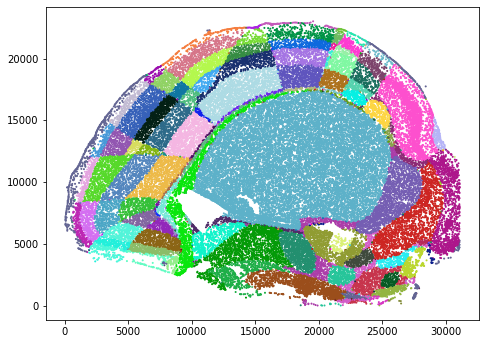

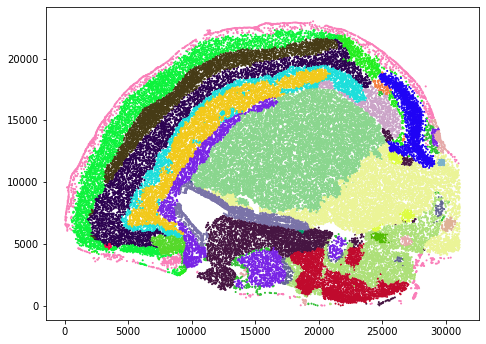

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)

(-1353.0, 28413.0, -1417.5, 29767.5)

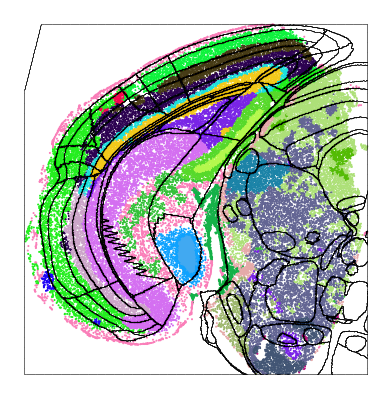

In [ ]:
i=14
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['col'],obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


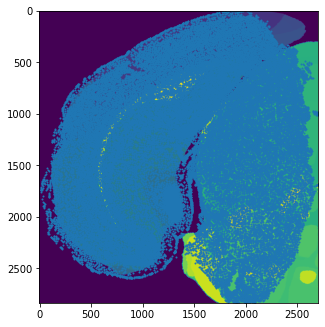

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((obs_wellplot['col'])/10,(max(obs_wellplot['row'])-obs_wellplot['row'])/10,s=1)

In [ ]:
rowlist=list(obs_wellplot['col']/10)
collist=list((max(obs_wellplot['row'])-obs_wellplot['row'])/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1394.5049999999999,
 29752.366904761904,
 -1249.5233746130045,
 28401.814396284855)

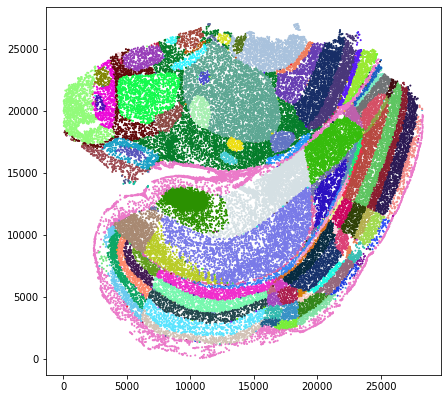

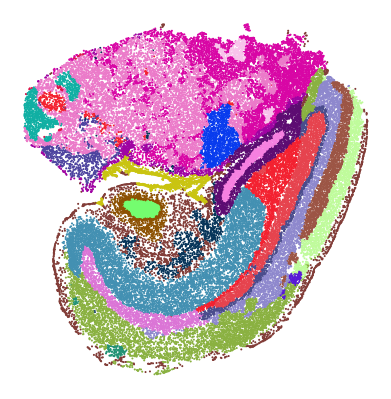

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)


plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

In [ ]:
# !pip install tifffile 
# !pip install imagecodecs 
# import numpy 
# import tifffile as tiff 

In [ ]:
i=15
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]


In [ ]:
import imageio

im = imageio.imread('tissue_region/output_data/annotation/well10_5_move-1.png')

col_int=[int(i) for i in obs_wellplot['col']/10]
row_int=[int(i) for i in (obs_wellplot['row'])/10]

obs_wellplot.loc[obs_wellplot.iloc[im[row_int,col_int]>0].index,'col']=3000+obs_wellplot.loc[obs_wellplot.iloc[im[row_int,col_int]>0].index,'col']

obs_wellplot.loc[obs_wellplot.iloc[im[row_int,col_int]>0].index,'row']=-2000+obs_wellplot.loc[obs_wellplot.iloc[im[row_int,col_int]>0].index,'row']

(-991.5, 20821.5, -1580.5, 33190.5)

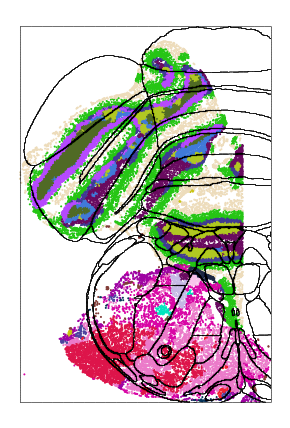

In [ ]:

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['col']))/4000,int(max(obs_wellplot['row']))/4000))
plt.scatter(obs_wellplot['col'],max(obs_wellplot['row'])-obs_wellplot['row'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*10,max(out_tplplot[0]*10)-out_tplplot[0]*10,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


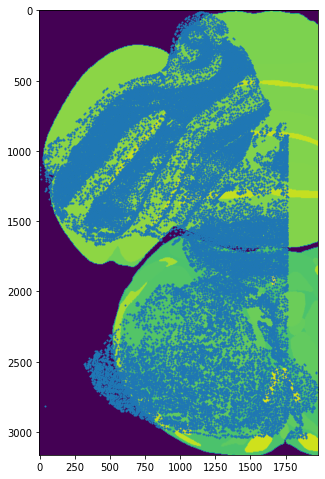

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04)
plt.scatter((obs_wellplot['col'])/10,obs_wellplot['row']/10,s=1)

In [ ]:
rowlist=list(obs_wellplot['col']/10)
collist=list(obs_wellplot['row']/10)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist]]

anatomical_region_label=np.array(st.name)[list(anatomical_region_id-1)]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[list(anatomical_parent_region_id-1)]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1396.6882435791229,
 31955.958997514514,
 -974.4979853479858,
 20767.967896389335)

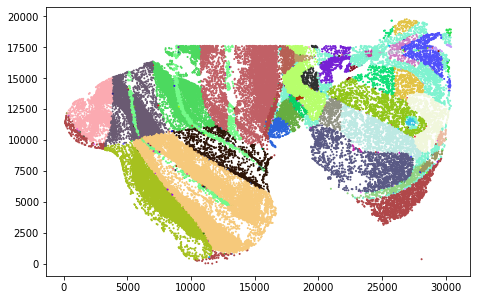

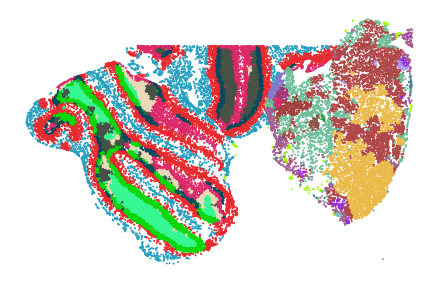

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)


plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

(-2592.6000000000004, 54444.6, -1229.1116028708122, 31110.34366028705)

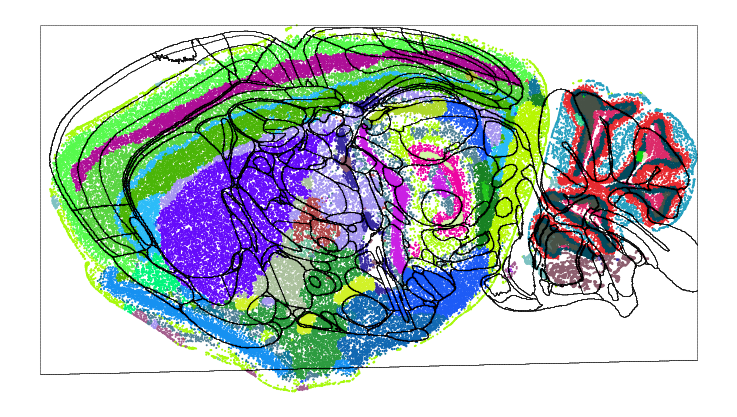

In [ ]:
i=16
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');
image04=np.append(image04,1+np.zeros([4322,13]),1)

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[0]*12,out_tplplot[1]*12,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


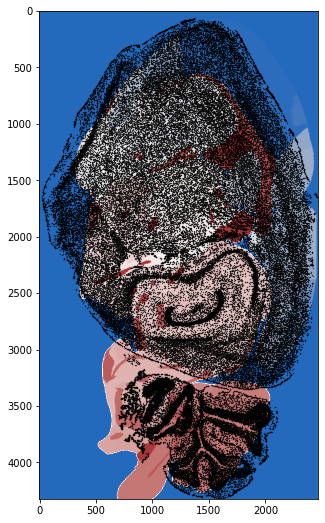

In [ ]:
plt.figure(figsize=(5,11))
plt.imshow(image04,cmap='vlag')
plt.scatter((obs_wellplot['col'])/12,(obs_wellplot['row'])/12,s=0.1,c='k')

In [ ]:
rowlist=list(obs_wellplot['col']/12)
collist=list((obs_wellplot['row'])/12)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[[int(i) for i in list(anatomical_region_id-1)]]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[[int(i) for i in list(anatomical_parent_region_id-1)]]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-1747.4888306545558,
 54363.68053808529,
 -1229.1116028708122,
 31110.34366028705)

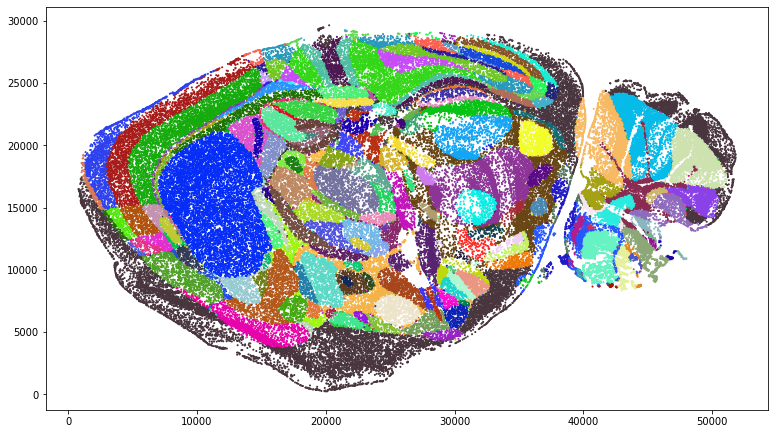

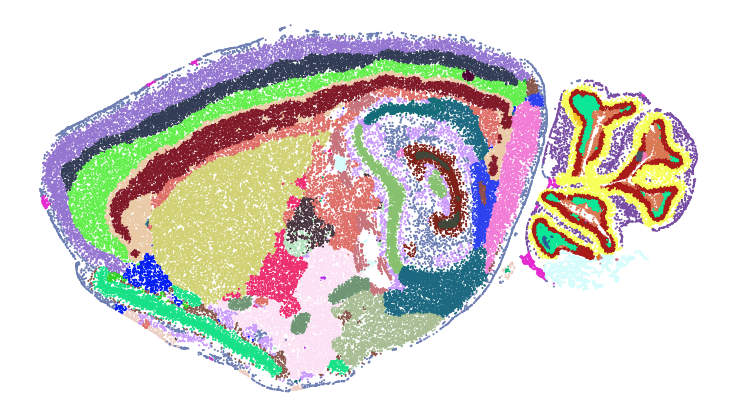

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)


plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

In [ ]:
i=17
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');
image04=np.append(image04,1+np.zeros([20,4574]),0)

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

# plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
# plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
#            c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
# plt.scatter(out_tplplot[1]*15,out_tplplot[0]*15,c='k',s=0.005,alpha=0.5)
# plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


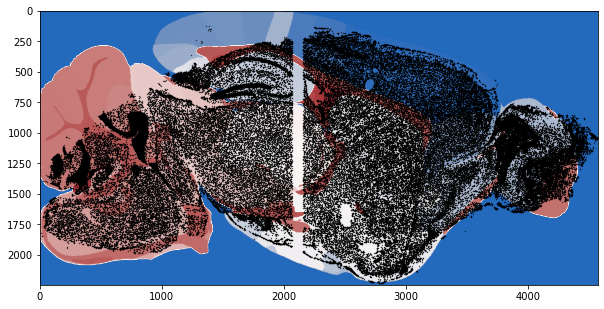

In [ ]:
plt.figure(figsize=(10,11))
plt.imshow(image04,cmap='vlag')
plt.scatter((obs_wellplot['row'])/15,(obs_wellplot['col'])/15,s=0.1,c='k')

In [ ]:
rowlist=list(obs_wellplot['row']/15)
collist=list((obs_wellplot['col'])/15)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[[int(i) for i in list(anatomical_region_id-1)]]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[[int(i) for i in list(anatomical_parent_region_id-1)]]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-3203.6701369863003, 71996.80621004564, 301.24545454545546, 35079.84545454545)

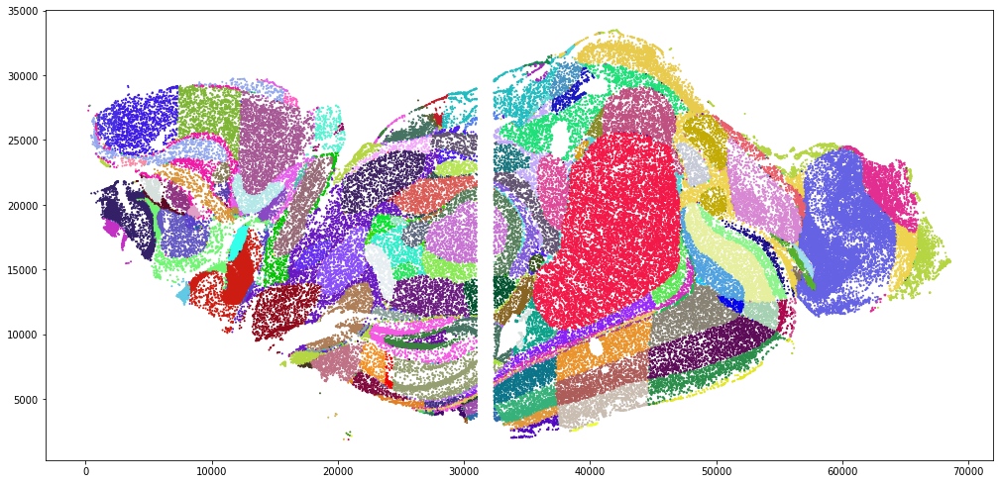

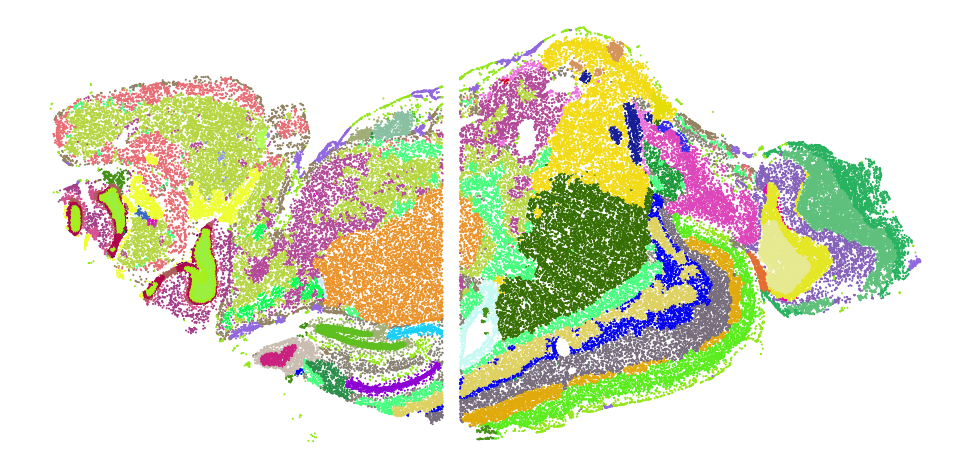

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)


plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

In [ ]:
image04.shape

(2422, 4841)

(-3872.0, 81312.0, -1952.8000000000002, 41008.8)

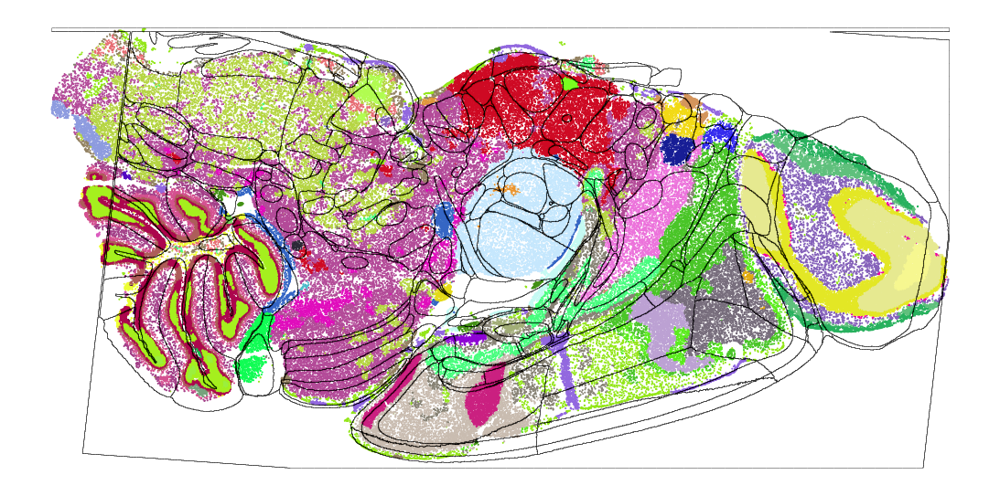

In [ ]:
i=18
focus_well=coronals[i]
obs_wellplot=adata1.obs.loc[adata1.obs['sample']==focus_well,:]

image04 = tifffile.imread('tissue_region/output_data/annotation/ccf_'+focus_well+'_celltypemap-rgb-1.tif');
image04=np.append(image04,1+np.zeros([20,4841]),0)

sx = ndimage.sobel(image04,axis=0,mode='constant')
sy = ndimage.sobel(image04,axis=1,mode='constant')
sobel=np.hypot(sx,sy)
out_tpl04 = np.nonzero(sobel)

out_tplplot=out_tpl04

plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.scatter(out_tplplot[1]*16,out_tplplot[0]*16,c='k',s=0.005,alpha=0.5)
plt.axis('off')

In [ ]:
### get parent
image04[image04==0]=1

st=pd.read_csv('tissue_region/output_data/annotation/structure_tree_safe_2017.csv')
st.index=1+st.index

ccf_id=st['id'];
ccf_parent_structure_id=st['parent_structure_id'];

unique_safe=np.unique(image04);

ccf_annotation_parent=image04.copy();
unique_safe_corrparent=ccf_parent_structure_id[unique_safe];
unique_parent=np.unique(unique_safe_corrparent);

ccf_annotation_parent[image04==1]=1;

for i in unique_safe[1:]:
  # print(i)
  test=image04==i;
  ccf_annotation_parent[test]=1+np.where(ccf_id==ccf_parent_structure_id[i])[0];


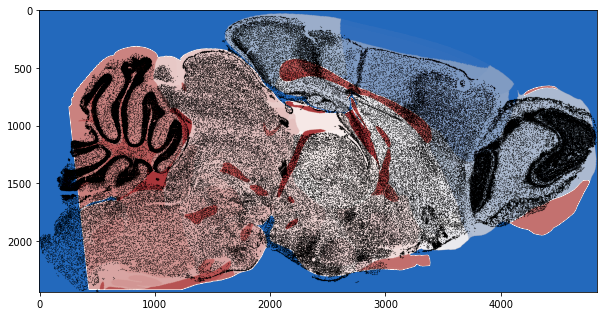

In [ ]:
plt.figure(figsize=(10,11))
plt.imshow(image04,cmap='vlag')
plt.scatter((obs_wellplot['row'])/16,(obs_wellplot['col'])/16,s=0.01,c='k')

In [ ]:
rowlist=list(obs_wellplot['row']/16)
collist=list((obs_wellplot['col'])/16)

### child
anatomical_region_id=image04[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_region_label=np.array(st.name)[[int(i) for i in list(anatomical_region_id-1)]]
obs_wellplot['anatomical_region_label']=anatomical_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_region_label']=anatomical_region_label

### parent
anatomical_parent_region_id=ccf_annotation_parent[[int(i) for i in collist],[int(i) for i in rowlist],]

anatomical_parent_region_label=np.array(st.name)[[int(i) for i in list(anatomical_parent_region_id-1)]]
obs_wellplot['anatomical_parent_region_label']=anatomical_parent_region_label
adata1.obs.loc[adata1.obs['sample']==focus_well,'anatomical_parent_region_label']=anatomical_parent_region_label


(-3846.082575757578, 81232.73409090914, -1162.6347670639198, 40866.47564824842)

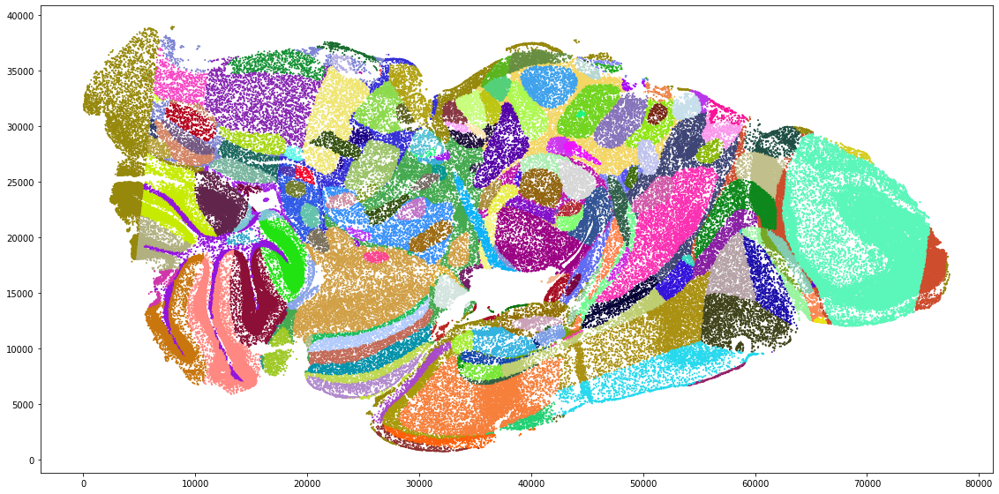

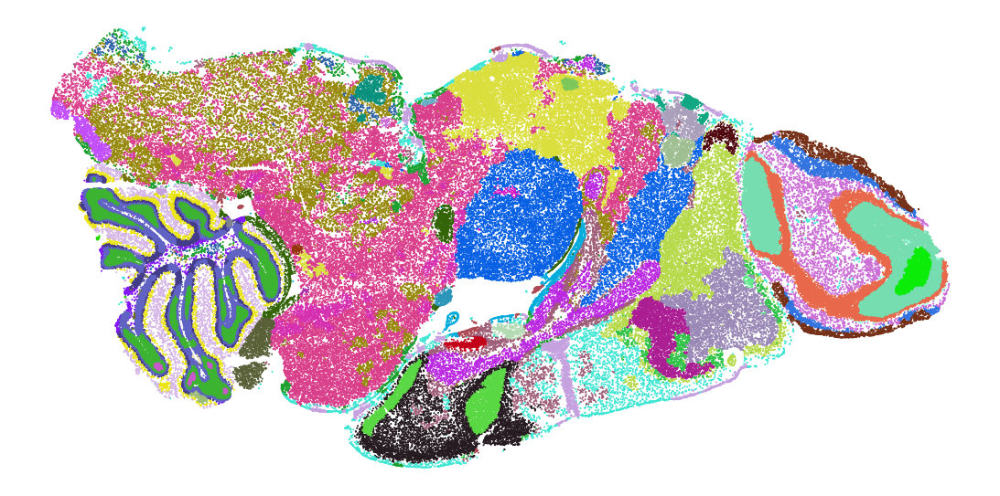

In [ ]:
cmap=np.random.rand(1500,3)
plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in anatomical_region_id]],s=1)


plt.figure(figsize=(int(max(obs_wellplot['row']))/4000,int(max(obs_wellplot['col']))/4000))
plt.scatter(obs_wellplot['row'],obs_wellplot['col'],
           c=cmap[[int(x) for x in obs_wellplot['tissue']]],s=1)
plt.axis('off')

In [ ]:
adata1.write_h5ad('adata1_with_tissue_label.h5ad')

In [ ]:
pwd

'/MultiClusterGAN/MyDrive/CNS'

In [4]:
adata=sc.read_h5ad('adata1_with_tissue_label.h5ad')

In [6]:
adata.obs

,sample,col,row,tissue,anatomical_region_label,anatomical_parent_region_label,anatomical_region_id
0,sagittal3,32050.916667,376.777778,45,root,root,NaN
1,sagittal3,31180.109375,730.031250,45,root,root,NaN
2,sagittal3,31231.711111,995.088889,45,root,root,NaN
3,sagittal3,31235.095238,808.761905,45,root,root,NaN
4,sagittal3,31441.180723,854.253012,45,root,root,NaN
...,...,...,...,...,...,...,...
47602-7,well3_5,12529.654135,30102.127820,34,Striatum,Cerebral nuclei,NaN
47603-7,well3_5,12392.578512,30191.504132,6,Olfactory tubercle,Striatum ventral region,NaN
47604-7,well3_5,12836.442308,29772.788462,34,lateral olfactory tract body,lateral olfactory tract general,NaN
47605-7,well3_5,13028.637931,29868.379310,34,lateral olfactory tract body,lateral olfactory tract general,NaN


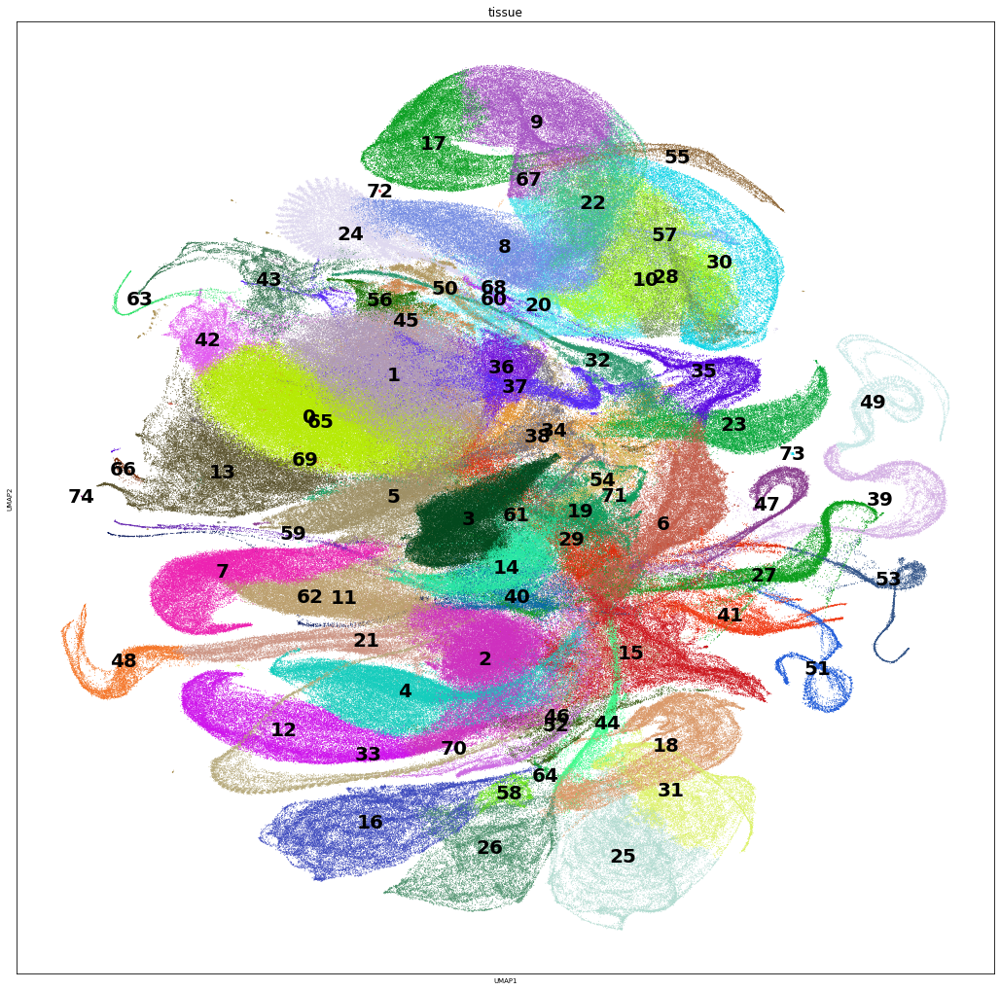

In [20]:
cluster_pl=list(np.random.rand(76,3))#sns.color_palette('tab20_r',2)
fig,ax = plt.subplots(figsize=(18,18))
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(7)
ax=sc.pl.umap(adata,color='tissue',legend_loc='on data',legend_fontsize=20,ax=ax,show=False,size=3,palette=cluster_pl)


end